# Explore the dataset


In this notebook, we will perform an EDA (Exploratory Data Analysis) on the processed Waymo dataset (data in the `processed` folder). In the first part, you will create a function to display 

In [1]:
# Ignore infos and warnings
import warnings
warnings.filterwarnings('ignore')
import tensorflow as tf
tf.get_logger().setLevel('ERROR')

import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import glob
import os
import re
import io
import cv2
import seaborn as sns
from tqdm import tqdm
from collections import Counter
from PIL import Image
from matplotlib.patches import Rectangle
from utils import get_dataset

%matplotlib inline

In [2]:
# Get all tfrecord filenames
filenames = glob.glob('./data/waymo/processed/*.tfrecord')

## Write a function to display an image and the bounding boxes

Implement the `display_instances` function below. This function takes a batch as an input and display an image with its corresponding bounding boxes. The only requirement is that the classes should be color coded (eg, vehicles in red, pedestrians in blue, cyclist in green).

In [12]:
def display_instances(batch):
    """
    This function takes a batch from the dataset and displays the images with 
    the associated bounding boxes.
    """
    """
    According to waymo-open-dataset/label.proto:
        TYPE_UNKOWN = 0
        TYPE_VEHICLE = 1
        TYPE_PEDESTRIAN = 2
        TYPE_SIGN = 3
        TYPE_CYCLIST = 4
    """
    color_map = {0: 'white',    
                 1: 'crimson', 
                 2: 'dodgerblue',
                 3: 'gold',
                 4: 'limegreen'}
    
    num_rows = int(np.ceil(len(batch) / 2))
    
    fig, axs = plt.subplots(num_rows, 2, figsize = (20, num_rows*10))
    for idx, sample in enumerate(batch):
        name = sample['filename']
        img = sample['image'].numpy()
        img_shape = img.shape

        bboxes = sample['groundtruth_boxes'].numpy()
        classes = sample['groundtruth_classes'].numpy()
        
        # Display image
        axs[idx//2][idx%2].axis('off')
        axs[idx//2][idx%2].imshow(img)

        # Display bounding boxes
        for cl, bb in zip(classes, bboxes):
            y1, x1, y2, x2 = bb
            y1 = y1 * img.shape[0]
            y2 = y2 * img.shape[0]
            x1 = x1 * img.shape[1]
            x2 = x2 * img.shape[1]

            axs[idx//2][idx%2].add_patch(Rectangle((x1,y1),  # origin
                                                    x2-x1,    # width
                                                    y2-y1,    # height
                                                    linewidth=2,
                                                    edgecolor=color_map[cl],
                                                    facecolor='none'))
    fig.tight_layout()        
    plt.show()

## Display 10 images 

Using the dataset created in the second cell and the function you just coded, display 10 random images with the associated bounding boxes. You can use the methods `take` and `shuffle` on the dataset.

In [7]:
# Select 10 tfrecords randomly
rand_idx = np.random.choice(np.arange(len(filenames)), 10)
subset = [filenames[idx] for idx in rand_idx]
datasets = [get_dataset(filename) for filename in subset]

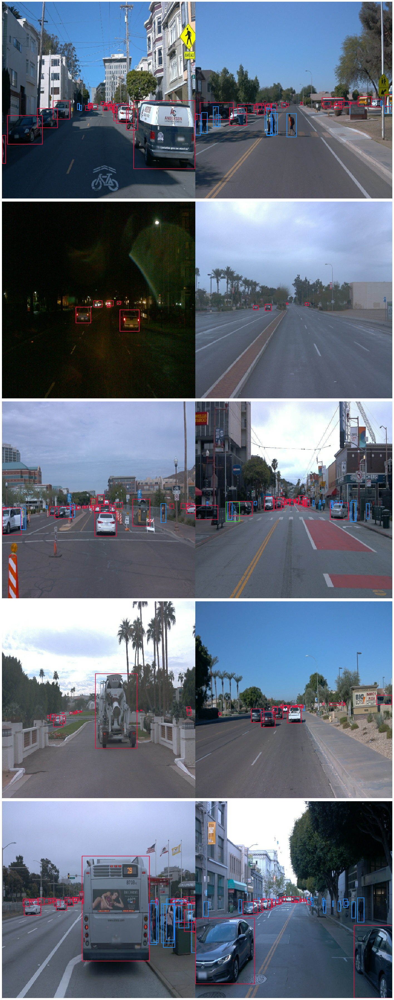

In [13]:
# Display 10 images
batch = [sample for data in datasets for sample in data.shuffle(1000).take(1)]
display_instances(batch)

## Additional EDA

In this last part, you are free to perform any additional analysis of the dataset. What else would like to know about the data?
For example, think about data distribution. So far, you have only looked at a single file...

In [14]:
# Load all tfrecords
datasets = [get_dataset(filename) for filename in filenames]

### Investigating the channel distribution of the images

In [16]:
def calculate_mean_std(image_list):
    """
    calculate mean and std of image list
    args:
    - image_list [array]: list of images as arrays
    returns:
    - mean [array]: 1x3 array of float, channel wise mean
    - std [array]: 1x3 array of float, channel wise std
    """
    mean = np.zeros((1, 3), dtype=float)
    std = np.zeros((1, 3), dtype=float)

    # calculate mean and std
    for img in image_list:
        mean += np.array([[np.mean(img[:,:,0]), 
                           np.mean(img[:,:,1]), 
                           np.mean(img[:,:,2])]])

        std += np.array([[np.sqrt(np.mean(np.square(img[:,:,0] - np.mean(img[:,:,0])))),
                          np.sqrt(np.mean(np.square(img[:,:,1] - np.mean(img[:,:,1])))),
                          np.sqrt(np.mean(np.square(img[:,:,2] - np.mean(img[:,:,2]))))]])

    mean = mean / len(image_list)    
    std = std / len(image_list)
    
    return mean, std

In [17]:
def channel_histogram(image_list):
    """
    calculate channel wise pixel value
    args:
    - image_list [list[str]]: list of image paths
    """
    red = []
    green = []
    blue = []

    for img in image_list:
        R, G, B = img[..., 0], img[..., 1], img[..., 2]
        red.extend(R.ravel().tolist())
        green.extend(G.ravel().tolist())
        blue.extend(B.ravel().tolist())
    
    plt.figure(figsize=((12,7)))
    plt.title('Channel histogram')
    sns.kdeplot(red, color='r')
    sns.kdeplot(green, color='g')
    sns.kdeplot(blue, color='b')
    plt.xlabel('Pixel values')
    plt.show()

In [18]:
# As the images in one sequence,i.e. one tfrecord, are similar to each other
# only one random image of each tfrecord is selected to represent the whole sequence
batch = [sample for data in datasets for sample in data.shuffle(1000).take(1)]

In [19]:
print(f'{len(batch)} images selected for further analysis')

97 images selected for further analysis


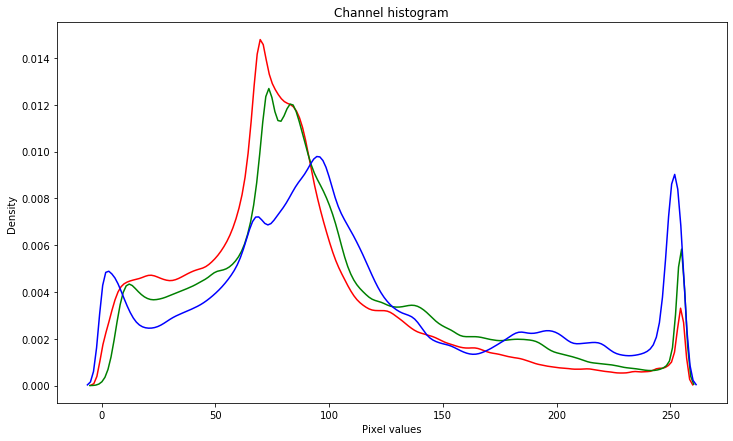

In [20]:
# Obtain a list of images
image_list = [sample['image'].numpy() for sample in batch]

# Show the channel histogram of all images
channel_histogram(image_list)

### Investigation images with respect to brightness and blurriness

In [21]:
# HLS images are used to distinguish dark from bright images by the lightness channel
hls_image_list = list(map(lambda x: cv2.cvtColor(x, cv2.COLOR_BGR2HLS), image_list))

# Get hls mean and std over all 97 images (selection see above)
hls_mean, hls_std = calculate_mean_std(hls_image_list)

dark_imgs = []
blurry_imgs = []
bright_imgs = []

for img in image_list:
    # Get mean and std for hls image
    hls_img  = cv2.cvtColor(img, cv2.COLOR_BGR2HLS)
    mean, std = calculate_mean_std([hls_img])
    
    # Compute focus measure to detect blurry images
    # Idea adopted from https://www.pyimagesearch.com/2015/09/07/blur-detection-with-opencv/
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    fm = cv2.Laplacian(gray, cv2.CV_64F).var() 
    
    if np.less(mean[..., 1], hls_mean[..., 1] - hls_std[..., 1]):
        dark_imgs.append(img)
    elif fm < 350:
        blurry_imgs.append(img)
    else:
        bright_imgs.append(img)
        
print(f'{len(dark_imgs)} dark images detected.')
print(f'{len(blurry_imgs)} blurry images detected.')
print(f'{len(bright_imgs)} bright images detected.')

8 dark images detected.
16 blurry images detected.
73 bright images detected.


In [22]:
def show_images(img_list):
    """
    Display all images contained in an image list. In each
    row three images are shown
    args:
    - image_list [img]: list of images
    """
    num_cols = 3
    num_rows = int(np.ceil(len(img_list) / num_cols))
    fig, axs = plt.subplots(num_rows, num_cols, figsize = (18, 6*num_rows))
    for idx, img in enumerate(img_list):       
        # Display image
        if num_rows == 1:
            axs[idx%num_cols].axis('off')
            axs[idx%num_cols].imshow(img)
        else:
            axs[idx//num_cols][idx%num_cols].axis('off')
            axs[idx//num_cols][idx%num_cols].imshow(img)
        
    # Display remaining axes elements as 'empty' 
    if len(img_list) < num_rows * num_cols:
        for idx in range(len(img_list), num_rows * num_cols):
            axs[idx//num_cols][idx%num_cols].axis('off')    
    
    fig.tight_layout()        
    plt.show()    

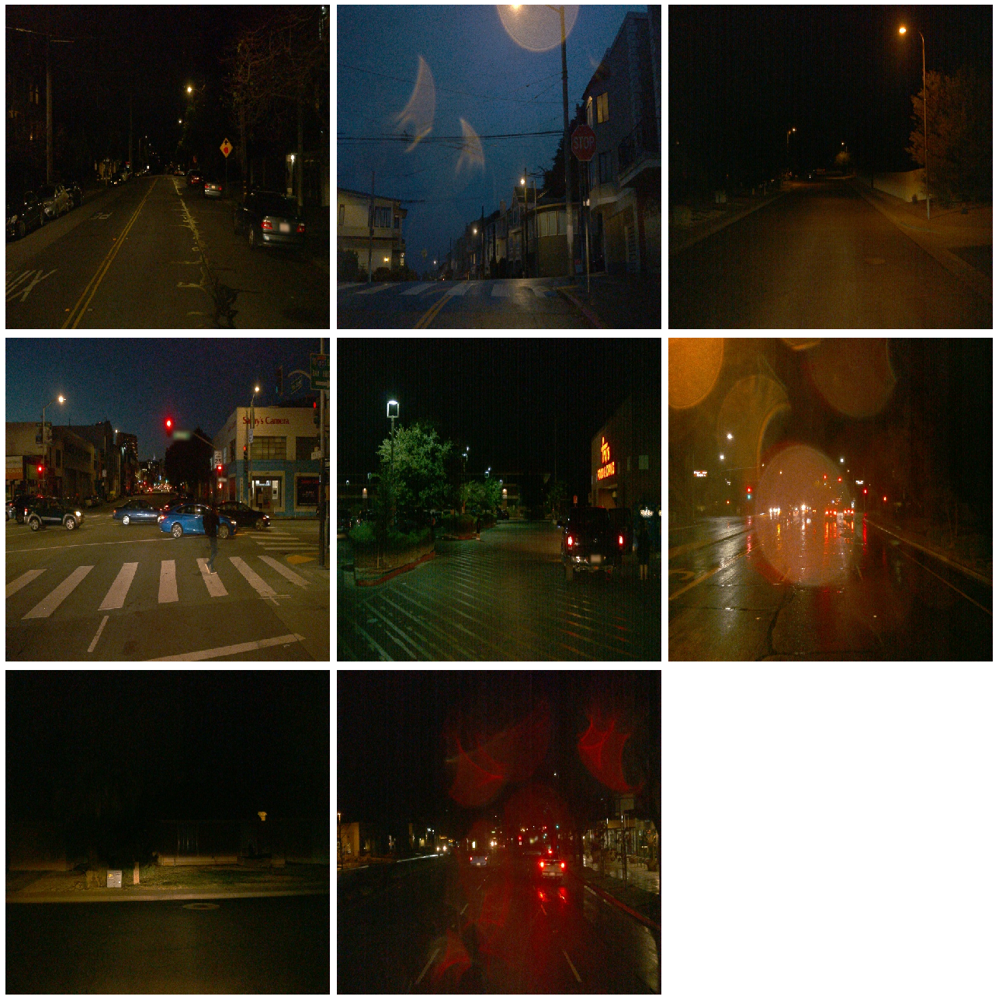

In [23]:
# Display dark images
show_images(dark_imgs)

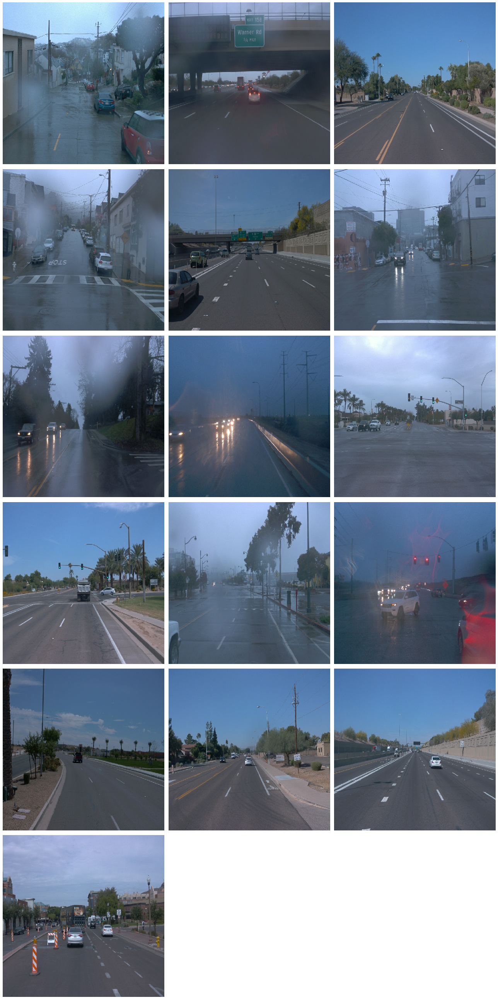

In [24]:
# Display blurry images
show_images(blurry_imgs)

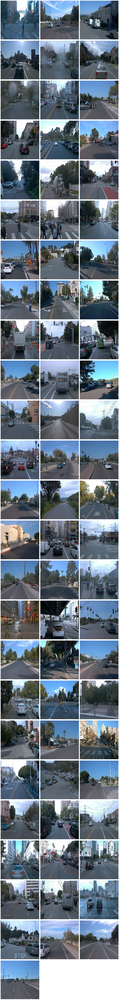

In [25]:
# Display bright images
show_images(bright_imgs)

#### Result: 
Although the separation is not perfect, e.g. some bright images are misclassified as blurry and blurry images as bright, it will help to split data appropriately into training and validation sets.

### Investigate class distribution

In [26]:
# Classes to be investigated
TOTAL = -1  # all classes
VEHICLE = 1
PEDESTRIAN = 2
CYCLIST = 4

classes = {TOTAL: [],
           VEHICLE: [],
           PEDESTRIAN: [],
           CYCLIST: []}

# Due to the high amount of data, the first 10000 samples of
# each dataset are selected representing the whole set
sample_size = 10000

for data in tqdm(datasets):
    cnter = Counter()
    # Count the number of class instances over all samples
    for sample in data.take(sample_size):
        cnter.update(sample['groundtruth_classes'].numpy())
    # Calculate the average amount of class instances for each
    # class and totally over all samples
    for key in classes:
        if key != TOTAL:
            classes[key].append(cnter[key]/sample_size)
        else:
            classes[TOTAL].append(len(list(cnter.elements()))/sample_size)

100%|███████████████████████████████████████████████████████████████████████████████████| 97/97 [05:56<00:00,  3.67s/it]


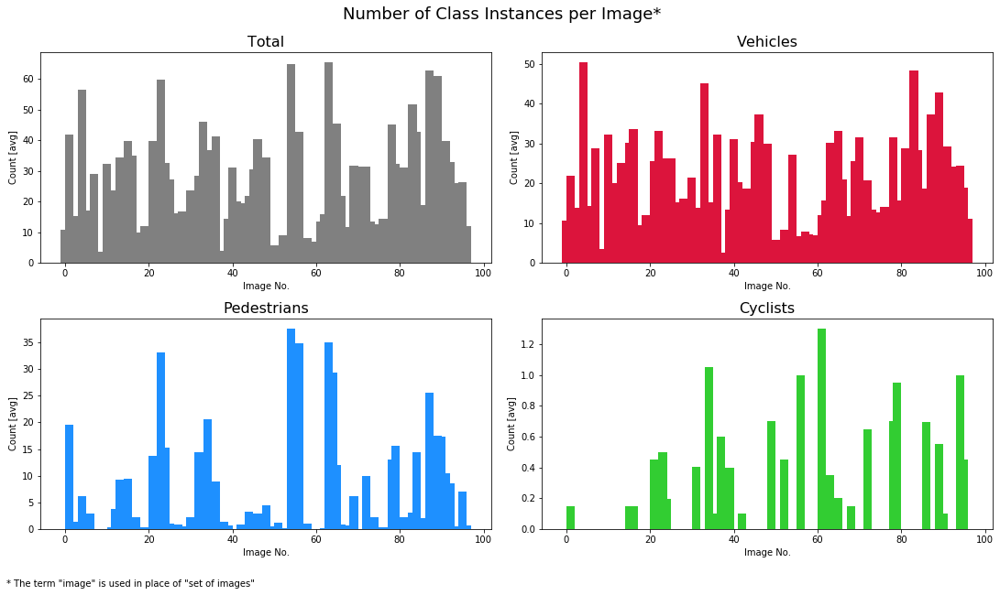

In [36]:
# Display the number of class instances over all images

fig, axs = plt.subplots(2, 2, figsize = (15, 8), constrained_layout=True)
fig.suptitle('Number of Class Instances per Image*', fontsize=18, y=1.05)

axs[0, 0].bar(list(range(0, 97)), classes[TOTAL], width=2, color='grey')
axs[0, 0].set_title('Total', fontsize=16)
axs[0, 0].set_xlabel('Image No.')
axs[0, 0].set_ylabel('Count [avg]')

axs[0, 1].bar(list(range(0, 97)), classes[VEHICLE], width=2, color='crimson')
axs[0, 1].set_title('Vehicles', fontsize=16)
axs[0, 1].set_xlabel('Image No.')
axs[0, 1].set_ylabel('Count [avg]')

axs[1, 0].bar(list(range(0, 97)), classes[PEDESTRIAN], width=2, color='dodgerblue')
axs[1, 0].set_title('Pedestrians', fontsize=16)
axs[1, 0].set_xlabel('Image No.')
axs[1, 0].set_ylabel('Count [avg]')

axs[1, 1].bar(list(range(0, 97)), classes[CYCLIST], width=2, color='limegreen')
axs[1, 1].set_title('Cyclists', fontsize=16)
axs[1, 1].set_xlabel('Image No.')
axs[1, 1].set_ylabel('Count [avg]')

plt.figtext(0, -0.05, '* The term "image" is used in place of "set of images"', ha='left')

plt.show()

### Result:
- Vehicles are the dominant class over all image sets. Some images contain lots of vehicles whereas a small amount of image sets displays only a low number of vehicles. As the amounts are averages over sets of 10000 images, it can be expected that some images contain no vehicle at all.
- There are lots of image sets with no pedestrians and even more with no cyclists. As there is no clustering of image sets with and without pedestrains/cyclists over the whole set of tfrecords, respectively, you should not expect to get unbalanced training and test sets with respect to theses classes by randomly drawing samples, put differently, both training and test sets will contain image sets with and without pedestrians/cyclists. Nevertheless the set of classes is unbalanced - there are more vehicles than pedestrians and more pedestrians than cyclists which will deteriorate the performance of a model in detecting pedestrians and cyclists.

### Train-Test-Split:
As differences in the quality of the images (dark, blurry, bright) have a strong impact on model performance - e.g. identifying vehicles in the dark is a different challenge compared to recognizing vehicles in daylight - creating training and test sets will take these differences into account. Images will be randomly chosen from each group (dark, blurry, bright) according to the train/test ratio. 